### Задача

Импортировать, предобработать и выгрузить данные.

### Импортируем библиотеки

In [1]:
import pandas as pd
import numpy as np
import csv
import io
import geopy.distance
import plotly.express as px
import itertools
import warnings
import sklearn

warnings.filterwarnings('ignore')

In [2]:
#sklearn.show_versions()

### Загружаем и оцениваем исходные данные

`calendar.csv` - календарь бронирования объектов.  
`listings.csv` - информация по каждому из объектов бронирования.  
`reviews.csv` - отзывы об объектах бронирования.

In [3]:
df_calendar = pd.read_csv('calendar.csv', sep=',')
df_listings = pd.read_csv('listings.csv', sep=',')
df_reviews = pd.read_csv('reviews.csv', sep=',')

In [4]:
print(df_calendar.info(), df_calendar.describe(include='all'))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1308890 entries, 0 to 1308889
Data columns (total 4 columns):
 #   Column      Non-Null Count    Dtype 
---  ------      --------------    ----- 
 0   listing_id  1308890 non-null  int64 
 1   date        1308890 non-null  object
 2   available   1308890 non-null  object
 3   price       643037 non-null   object
dtypes: int64(1), object(3)
memory usage: 39.9+ MB
None           listing_id        date available    price
count   1.308890e+06     1308890   1308890   643037
unique           NaN         365         2     1246
top              NaN  2017-09-05         f  $150.00
freq             NaN        3586    665853    20752
mean    8.442118e+06         NaN       NaN      NaN
std     4.500149e+06         NaN       NaN      NaN
min     3.353000e+03         NaN       NaN      NaN
25%     4.679319e+06         NaN       NaN      NaN
50%     8.578710e+06         NaN       NaN      NaN
75%     1.279603e+07         NaN       NaN      NaN
max     

In [5]:
print(df_listings.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3585 entries, 0 to 3584
Data columns (total 95 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                3585 non-null   int64  
 1   listing_url                       3585 non-null   object 
 2   scrape_id                         3585 non-null   int64  
 3   last_scraped                      3585 non-null   object 
 4   name                              3585 non-null   object 
 5   summary                           3442 non-null   object 
 6   space                             2528 non-null   object 
 7   description                       3585 non-null   object 
 8   experiences_offered               3585 non-null   object 
 9   neighborhood_overview             2170 non-null   object 
 10  notes                             1610 non-null   object 
 11  transit                           2295 non-null   object 
 12  access

In [6]:
print(df_reviews.info(), df_reviews.describe(include='all'))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68275 entries, 0 to 68274
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   listing_id     68275 non-null  int64 
 1   id             68275 non-null  int64 
 2   date           68275 non-null  object
 3   reviewer_id    68275 non-null  int64 
 4   reviewer_name  68275 non-null  object
 5   comments       68222 non-null  object
dtypes: int64(3), object(3)
memory usage: 3.1+ MB
None           listing_id            id        date   reviewer_id reviewer_name  \
count   6.827500e+04  6.827500e+04       68275  6.827500e+04         68275   
unique           NaN           NaN        2045           NaN         14775   
top              NaN           NaN  2016-04-19           NaN         David   
freq             NaN           NaN         342           NaN           654   
mean    4.759910e+06  5.246516e+07         NaN  2.802389e+07           NaN   
std     3.788990e+06  2.7

В данных присутствуют пропуски и пустые столбцы.

#### ДатаФрейм `df_calendar`

Оценим первое и последнее значение в датафрейма `df_calendar`:

In [7]:
print(df_calendar.date.min(),df_calendar.date.max())

2016-09-06 2017-09-05


По условию задания нам надо найти свободные даты для бронирования в первой половине 2017 года. Сделаем срез с подходящими данными:

In [8]:
df_calendar = df_calendar[( df_calendar.date >= '2017-01-01' ) & ( df_calendar.date < '2017-07-01' ) & ( df_calendar.available == 't' )]

Изменим формат столбца `date` на *datetime64[ns]*

In [9]:
df_calendar.info()

<class 'pandas.core.frame.DataFrame'>
Index: 332885 entries, 418 to 1308696
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   listing_id  332885 non-null  int64 
 1   date        332885 non-null  object
 2   available   332885 non-null  object
 3   price       332885 non-null  object
dtypes: int64(1), object(3)
memory usage: 12.7+ MB


In [10]:
df_calendar['date'] = df_calendar['date'].astype('datetime64[ns]')

По условию задания нам необходимо разместить гостей на 3 дня подрят. Значит нам необходимо отобрать только те даты, которые удовлетворяют этому условию. Сделаем это с помощью перебора в цикле:

In [11]:
# создаем пустой датафрейм df_temp
df_temp = pd.DataFrame()

# Создаем цикл по каждому уникальному id объекта
for i in df_calendar.listing_id.unique():

    # делаем срез датафрейма df_calendar для каждого уникального id объекта
    df = df_calendar[df_calendar.listing_id == i]

    # сортируем срез по дате
    df = df.sort_values(by='date')

    # Вычисляем разницу в днях между каждой последующей и предыдущей датой в столбце 'date'. 
    # Результат сохраняется в новом столбце 'diff'.
    df['diff'] = df['date'].diff().dt.days
    
    # Cоздаем новый столбец 'group', который группирует данные на основе последовательности дат.
    # Если разница в днях не равна 1 (что указывает на прерывание последовательности),начинается новая группа.
    # Функция .cumsum() накапливает сумму, образуя уникальные идентификаторы для каждой группы.
    df['group'] = ((df['diff'] != 1) & (df['diff'].shift(-1) != 1)).cumsum()
    
    # Для каждой группы, созданной в предыдущем шаге, вычисляется количество дат.
    # Результат помещается в новый столбец 'count', который показывает, сколько дат входит в каждую группу.
    df['count'] = df.groupby('group')['date'].transform('count')

    # Фильтруем df для получения только тех групп, где есть 3 и более подряд идущих даты
    # Удаляем лишние столбцы
    result_df = df[df['count'] >= 3].drop(columns=['diff', 'group', 'count'])

    # суммируем полученные результаты в датафрейм df_final
    df_temp = pd.concat([df_temp, result_df], ignore_index = True)

# Обновляем индекс в датафрейме df_temp
df_temp.reset_index(drop = True, inplace = True)

Оценим датафрейм df_final `df_temp`

In [12]:
df_temp

,listing_id,date,available,price
0,3075044,2017-01-01,t,$65.00
1,3075044,2017-01-02,t,$65.00
2,3075044,2017-01-03,t,$65.00
3,3075044,2017-01-04,t,$65.00
4,3075044,2017-01-05,t,$65.00
...,...,...,...,...
332825,14504422,2017-02-28,t,$65.00
332826,14504422,2017-03-01,t,$65.00
332827,14504422,2017-03-02,t,$65.00
332828,14504422,2017-03-03,t,$65.00


In [13]:
df_temp.isna().sum()

listing_id    0
date          0
available     0
price         0
dtype: int64

In [14]:
df_temp.duplicated().sum()

0

Дубликатов и пропусков нет. Удалим столбец `available`, он нам больше не нужен.

In [15]:
df_temp.drop(['available'], axis=1, inplace=True)

В столбце `price` изменим тип данных на *int*. Для этого напишем цикл, который переберет все значения столбца `price`, удалит лишние знаки (`$`и `,`) и изменит тип данных:

In [16]:
for i in range(len(df_temp)):
    df_temp.price[i] = int(float(str(df_temp.price[i]).replace('$', '').replace(',', '')))

df_temp['price'] = df_temp['price'].astype('int')

In [17]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 332830 entries, 0 to 332829
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   listing_id  332830 non-null  int64         
 1   date        332830 non-null  datetime64[ns]
 2   price       332830 non-null  int32         
dtypes: datetime64[ns](1), int32(1), int64(1)
memory usage: 6.3 MB


In [18]:
df_temp.describe(include='all')

,listing_id,date,price
count,3.328300e+05,332830,332830.000000
mean,7.540951e+06,2017-03-28 18:07:53.106390528,188.482955
min,3.353000e+03,2017-01-01 00:00:00,20.000000
25%,3.401809e+06,2017-02-10 00:00:00,85.000000
50%,7.527149e+06,2017-03-26 00:00:00,150.000000
75%,1.217596e+07,2017-05-14 00:00:00,249.000000
max,1.493346e+07,2017-06-30 00:00:00,4000.000000
std,4.777204e+06,NaN,174.168207


Визуально оценим распределение `price`:

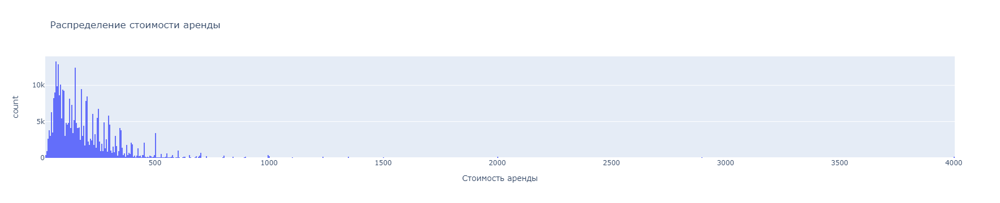

In [19]:
fig = px.histogram(df_temp['price'], title='Распределение стоимости аренды', nbins=1000, labels={'value': 'Стоимость аренды', 'count':'Количество '})
fig.update_layout(showlegend=False)

fig.show()

Визуально присутствуют выбросы в области максимальных значений.

#### ДатаФрейм `df_listings`

Оценим ДатаФрейм `df_listings`:

In [20]:
df_listings.sample(5)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
2700,8720673,https://www.airbnb.com/rooms/8720673,20160906204935,2016-09-07,A HOME AWAY FROM HOME,Nice clean place to stay for a few days,Nice quiet neighborhood clean hose with nice p...,Nice clean place to stay for a few days Nice q...,none,My neighborhood is a nice quiet and lovely pla...,...,8.0,f,NaN,NaN,f,flexible,f,f,2,0.19
2646,14698794,https://www.airbnb.com/rooms/14698794,20160906204935,2016-09-07,Private room near Harvard Business School,Quiet room with two twin beds. Near Harvard Bu...,2nd Floor bedroom features two twin beds. AC a...,Quiet room with two twin beds. Near Harvard Bu...,none,Walking distance to many attractions including...,...,9.0,f,NaN,NaN,f,strict,f,f,1,3.00
1380,12953937,https://www.airbnb.com/rooms/12953937,20160906204935,2016-09-07,Charming south end brownstone,"Two blocks from Copley square, back bay train ...",NaN,"Two blocks from Copley square, back bay train ...",none,"Featuring a 99 walk score, you are steps away ...",...,10.0,f,NaN,NaN,f,moderate,f,f,1,3.61
1300,9993826,https://www.airbnb.com/rooms/9993826,20160906204935,2016-09-07,Lux 1BR Back Bay Apt,This beautiful apartment is complete with a fu...,B206/210,This beautiful apartment is complete with a fu...,none,This apartment is located at the crossroads of...,...,NaN,f,NaN,NaN,f,strict,f,f,136,NaN
3120,7853971,https://www.airbnb.com/rooms/7853971,20160906204935,2016-09-07,Brand New! South Boston 1 bedroom,Brand new property completed July 2015! Locate...,NaN,Brand new property completed July 2015! Locate...,none,NaN,...,10.0,f,NaN,NaN,f,strict,f,f,19,1.25


In [21]:
df_listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3585 entries, 0 to 3584
Data columns (total 95 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                3585 non-null   int64  
 1   listing_url                       3585 non-null   object 
 2   scrape_id                         3585 non-null   int64  
 3   last_scraped                      3585 non-null   object 
 4   name                              3585 non-null   object 
 5   summary                           3442 non-null   object 
 6   space                             2528 non-null   object 
 7   description                       3585 non-null   object 
 8   experiences_offered               3585 non-null   object 
 9   neighborhood_overview             2170 non-null   object 
 10  notes                             1610 non-null   object 
 11  transit                           2295 non-null   object 
 12  access

In [22]:
df_listings.describe(include='all')

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
count,3.585000e+03,3585,3.585000e+03,3585,3585,3442,2528,3585,3585,2170,...,2764.000000,3585,0.0,0.0,3585,3585,3585,3585,3585.000000,2829.000000
unique,NaN,3585,NaN,1,3504,3113,2268,3423,1,1728,...,NaN,1,NaN,NaN,2,4,2,2,NaN,NaN
top,NaN,https://www.airbnb.com/rooms/12147973,NaN,2016-09-07,Lux 2BR by Fenway w/WiFi,"The unit is stylishly designed for comfort, va...",The studio's kitchenette comes equipped with a...,"The unit is stylishly designed for comfort, va...",none,Conveniently bordering the neighborhoods of th...,...,NaN,f,NaN,NaN,f,strict,f,f,NaN,NaN
freq,NaN,1,NaN,3585,8,21,17,7,3585,21,...,NaN,3585,NaN,NaN,2991,1582,3518,3348,NaN,NaN
mean,8.440875e+06,NaN,2.016091e+13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.168234,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.733891,1.970908
std,4.500787e+06,NaN,8.516813e-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.011116,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.415076,2.120561
min,3.353000e+03,NaN,2.016091e+13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,0.010000
25%,4.679319e+06,NaN,2.016091e+13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,0.480000
50%,8.577620e+06,NaN,2.016091e+13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,1.170000
75%,1.278953e+07,NaN,2.016091e+13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,10.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.000000,2.720000


Присутствуют пропуски, пустые столбцы, неверные типы данных.  
Удалим лишние столбцы:

In [23]:
columns_drop = ['listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space', 'description', 'experiences_offered', 'neighborhood_overview', 'notes', 'transit', 'access', 'interaction', 'thumbnail_url', 'medium_url', 'picture_url'
                ,'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_since', 'host_location', 'host_about', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_is_superhost', 'host_thumbnail_url', 'host_picture_url'
                ,'host_neighbourhood', 'host_listings_count', 'host_total_listings_count', 'host_verifications', 'host_has_profile_pic', 'host_identity_verified', 'neighbourhood', 'neighbourhood_group_cleansed', 'city', 'state', 'market', 'smart_location'
                ,'country_code', 'country', 'weekly_price', 'monthly_price', 'calendar_updated', 'has_availability', 'availability_30', 'availability_60', 'availability_90', 'availability_365', 'calendar_last_scraped', 'first_review', 'last_review'
                ,'requires_license', 'license', 'jurisdiction_names', 'instant_bookable', 'cancellation_policy', 'require_guest_profile_picture', 'require_guest_phone_verification', 'calculated_host_listings_count', 'reviews_per_month', 'square_feet'
                ,'zipcode', 'price' 
                ,'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value'
               ]

In [24]:
df_listings.drop(columns_drop, axis=1, inplace=True)

Переименуем столбец `id` в `listing_id` 

In [25]:
df_listings.rename(columns = {'id' : 'listing_id'}, inplace = True)

Объединеним ДатаФреймы df_temp и df_listings по столбцу 'listing_id' с использованием левого соединения (left join):

In [26]:
df_final = pd.merge(df_temp, df_listings, on='listing_id', how='left')

In [27]:
df_final.sample(5)

,listing_id,date,price,house_rules,street,neighbourhood_cleansed,latitude,longitude,is_location_exact,property_type,...,bed_type,amenities,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,number_of_reviews,review_scores_rating
217568,6167184,2017-02-17,200,No smoking and no pets please.,"Burbank St, Boston, MA 02115, United States",Fenway,42.343991,-71.087938,f,Apartment,...,Real Bed,"{""Wireless Internet"",Kitchen,""Hot Tub"",Heating...",NaN,NaN,1,$7.00,1,14,18,83.0
13896,7879708,2017-05-04,75,"We plan to treat you politely, warmly, and wit...","Wenham Street, Boston, MA 02130, United States",Jamaica Plain,42.295593,-71.115301,t,Condominium,...,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,NaN,1,$0.00,2,1125,12,100.0
328554,14848154,2017-06-11,88,1. No damage to the house or furniture 2. No S...,"Franklin Avenue, Somerville, MA 02145, United ...",Charlestown,42.380773,-71.085185,f,Apartment,...,Real Bed,"{TV,Internet,""Wireless Internet"",""Air Conditio...",$95.00,NaN,2,$24.00,1,1125,0,NaN
236605,3412990,2017-02-28,60,Please do not smoke. Be respectful of other gu...,"Ridgemont Street, Boston, MA 02134, United States",Brighton,42.351593,-71.144211,t,House,...,Real Bed,"{Internet,""Wireless Internet"",Kitchen,""Free Pa...",NaN,$10.00,1,$20.00,30,1125,60,90.0
179483,11120777,2017-04-25,355,"Be quiet, kind and respectful, treat this as i...","Charles Street, Boston, MA 02114, United States",Beacon Hill,42.359654,-71.070410,f,Apartment,...,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",$199.00,$65.00,4,$50.00,1,1125,24,96.0


#### Столбец `maximum_nights`

`maximum_nights` - это максимальное количество ночей, на которые можно арендовать объект.  
По условию мы должны арендовать на 3 полных дня подрят. Это значит, что значение в столбце должно быть больше или равно 3. Лишние данные удалим.

In [28]:
df_final = df_final[df_final.maximum_nights >= 3]
df_final = df_final[df_final.minimum_nights <= 15]
df_final.drop(['maximum_nights'], axis=1, inplace=True)
df_final.reset_index(drop = True, inplace = True)

In [29]:
df_final.shape

(323322, 24)

#### Столбец `extra_people`

`extra_people` - это доплата за одного дополнительного гостя за 1 день. Нужно сменить тип данных и убрать лишние знаки (`$`и `,`). Поступим аналогично тому, как мы поступили со столбцом `price`:

In [30]:
for i in range(len(df_final)):
    df_final.extra_people[i] = int(float(str(df_final.extra_people[i]).replace('$', '').replace(',', '')))

df_final.extra_people = df_final.extra_people.astype('int')

#### Столбцы `cleaning_fee` и `security_deposit`

`cleaning_fee` - это стоимость уборки.  
`security_deposit` - это залог за сохранность имущества.  
Оба эти признака содержат пропуски. Сделаем допущение, что пропуски подразумевают отсутствие стоимости уборки и депозита. Поэтому заменим пропуски на 0:

In [31]:
df_final['cleaning_fee'] = df_final['cleaning_fee'].fillna(0)
df_final['security_deposit'] = df_final['security_deposit'].fillna(0)

Так же нам нужно сменить тип данных и убрать лишние знаки (`$`и `,`). Поступим аналогично тому, как мы поступили со столбцом `price`:

In [32]:
for i in range(len(df_final)):
    df_final['cleaning_fee'][i] = str(df_final['cleaning_fee'][i]).replace('$', '').replace(',', '')
    df_final['security_deposit'][i] = str(df_final['security_deposit'][i]).replace('$', '').replace(',', '')

df_final['cleaning_fee'] = df_final['cleaning_fee'].astype(float).astype(int)
df_final['security_deposit'] = df_final['security_deposit'].astype(float).astype(int)

In [33]:
df_final.isna().sum()

listing_id                    0
date                          0
price                         0
house_rules               87113
street                        0
neighbourhood_cleansed        0
latitude                      0
longitude                     0
is_location_exact             0
property_type                19
room_type                     0
accommodates                  0
bathrooms                  2296
bedrooms                   1800
beds                       1246
bed_type                      0
amenities                     0
security_deposit              0
cleaning_fee                  0
guests_included               0
extra_people                  0
minimum_nights                0
number_of_reviews             0
review_scores_rating      58154
dtype: int64

#### Оценим столбец `beds`

`beds` - это количество кроватей.  
Мы сформулировали правило, что для комфортного пребывания для каждого гостя должна быть отдельная кровать. Поэтому `beds` - одна из ключевых метрик.
Оценим распределение кроватей на объектах:

In [34]:
df_final.beds.isna().sum()

1246

In [35]:
df_final.beds.value_counts()

beds
1.0    192608
2.0     83196
3.0     25767
4.0     12203
5.0      4096
6.0      2226
8.0       893
7.0       780
9.0       250
0.0        57
Name: count, dtype: int64

У нас 1246 пропусков и 57 объектов без кроватей. т.к. эти аномалии составляют менее 1% от датасета, то удалим их все. заодно сменим тип данных на int:

In [36]:
df_final.beds[df_final.beds == 0] = np.nan

In [37]:
df_final = df_final.dropna(subset=['beds'])
df_final.reset_index(drop = True, inplace = True)

In [38]:
df_final.shape

(322019, 24)

#### Оценим столбец `property_type`:

`property_type` - это тип объекста

In [39]:
df_final.property_type.isna().sum()

19

Удалим 19 пропусков:

In [40]:
df_final = df_final.dropna(subset=['property_type'])
df_final.reset_index(drop = True, inplace = True)

In [41]:
df_final.shape

(322000, 24)

#### Оценим столбец `bedrooms`:

`bedrooms` - это количество спальных комнат.

In [42]:
df_final.bedrooms.isna().sum()

1800

In [43]:
df_final.bedrooms.value_counts()

bedrooms
1.0    210180
2.0     59585
0.0     27541
3.0     16638
4.0      4743
5.0      1513
Name: count, dtype: int64

Оценим 1800 пропусков:

In [44]:
df_final.property_type[df_final.bedrooms.isna()].value_counts()

property_type
Apartment    1800
Name: count, dtype: int64

Все пропуски соответствуют типу Apartment. Рассмотрим подробнее:

In [45]:
df_final[['property_type','beds']][df_final.bedrooms.isna()].value_counts()

property_type  beds
Apartment      1.0     1800
Name: count, dtype: int64

Все эти аппартаменты имеют одну кровать. Значит и спальня там тоже одна. Заменяем пропуски на 1, а тип данных на int:

In [46]:
df_final.bedrooms[df_final.bedrooms.isna()] = 1
df_final.bedrooms[df_final.bedrooms == 0] = 1
df_final['bedrooms'] = df_final['bedrooms'].astype(float).astype(int)

#### Оценим столбец `bathrooms`:

`bathrooms` - это количество ванных комнат. При этом ванная с туалетом отображаются как целое число (например 2.0), а наличие дополнительного отдельног туалета отображается как 0.5.  
Мы сформулировали правило, что для комфортного проживания на одну ванную должно приходится не более 2-х гостей. Поэтому `bathrooms` - одна из ключевых метрик.
Оценим данные:

In [47]:
df_final.bathrooms.isna().sum()

1412

In [48]:
df_final.bathrooms.value_counts()

bathrooms
1.0    243701
2.0     41102
1.5     20336
2.5      7879
0.0      1810
3.0      1658
3.5      1526
5.0       787
6.0       724
0.5       543
4.0       352
4.5       170
Name: count, dtype: int64

Оценим пропуски:

In [49]:

df_final[['property_type','bedrooms','beds']][df_final.bathrooms.isna()].value_counts()

property_type    bedrooms  beds
House            1         1.0     537
Apartment        1         1.0     513
                 2         2.0     181
Bed & Breakfast  1         1.0     181
Name: count, dtype: int64

Тут трудно найти какую-то взаимосвязь. Полагаю, что апартаменты с 2-мя спальнями должны укоплектовываться ванной. В любом случае, пропусков мало и если их удалить, то они не смогут оказать весомое влияние на результат исследования. Поэтому удаляем пропуски:

In [50]:
df_final = df_final.dropna(subset=['bathrooms'])
df_final.reset_index(drop = True, inplace = True)

In [51]:
df_final.shape

(320588, 24)

In [52]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320588 entries, 0 to 320587
Data columns (total 24 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   listing_id              320588 non-null  int64         
 1   date                    320588 non-null  datetime64[ns]
 2   price                   320588 non-null  int32         
 3   house_rules             234691 non-null  object        
 4   street                  320588 non-null  object        
 5   neighbourhood_cleansed  320588 non-null  object        
 6   latitude                320588 non-null  float64       
 7   longitude               320588 non-null  float64       
 8   is_location_exact       320588 non-null  object        
 9   property_type           320588 non-null  object        
 10  room_type               320588 non-null  object        
 11  accommodates            320588 non-null  int64         
 12  bathrooms               320588

In [53]:
df_final['bathrooms'] = df_final['bathrooms'].apply(np.ceil) 

#### Оценим столбец `review_scores_rating`

`review_scores_rating` - это рейтинг объекта на сайте Airbnb, основанный на отзывах пользователей.  
Одна из метрик, на которой основывается рейтинг `satisfaction`.

In [54]:
df_final.review_scores_rating.isna().sum()

57792

In [55]:
df_final.review_scores_rating.median()

93.0

Медиана 93 означает, что гости, в основном, склонны ставить высокие оценки. В свою очередь, это означает, что данная метрика не может быть основной для `satisfaction`.  
58946 пропусков - это достаточно большое значение. Там могут оказаться объекты, которые еще ни разу не сдавались и поэтому не имеют оценок. Я предлагаю заменить пропуски на 0. Таким образом, мы сохраним данные, но они не окажут влияния при оценке удовлетворенности:

In [56]:
df_final['review_scores_rating'] = df_final['review_scores_rating'].fillna(0)

In [57]:
df_final.shape

(320588, 24)

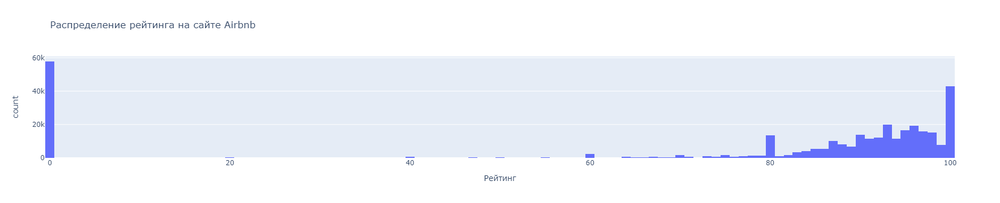

In [58]:
fig = px.histogram(df_final['review_scores_rating'], title='Распределение рейтинга на сайте Airbnb', nbins=200, labels={'value': 'Рейтинг', 'count':'Количество'})
fig.update_layout(showlegend=False)

fig.show()

Визуально присутствует 3 выброса со значениями рейтинга 100, 80 и 0.

In [59]:
df_final.number_of_reviews[df_final['review_scores_rating'] == 80].value_counts().head(5)

number_of_reviews
1    4664
2    3967
4    1283
3     772
5     302
Name: count, dtype: int64

In [60]:
df_final.number_of_reviews[df_final['review_scores_rating'] == 100].value_counts().head(5)

number_of_reviews
1    13791
2     8167
3     5114
4     3882
5     2088
Name: count, dtype: int64

Оба выброса можно объяснить отсутствием достаточного количества отзывов для каждого конкретного объекта

In [61]:
df_final.isna().sum()

listing_id                    0
date                          0
price                         0
house_rules               85897
street                        0
neighbourhood_cleansed        0
latitude                      0
longitude                     0
is_location_exact             0
property_type                 0
room_type                     0
accommodates                  0
bathrooms                     0
bedrooms                      0
beds                          0
bed_type                      0
amenities                     0
security_deposit              0
cleaning_fee                  0
guests_included               0
extra_people                  0
minimum_nights                0
number_of_reviews             0
review_scores_rating          0
dtype: int64

In [62]:
df_final.describe(include='all')

,listing_id,date,price,house_rules,street,neighbourhood_cleansed,latitude,longitude,is_location_exact,property_type,...,beds,bed_type,amenities,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,number_of_reviews,review_scores_rating
count,3.205880e+05,320588,320588.000000,234691,320588,320588,320588.000000,320588.000000,320588,320588,...,320588.000000,320588,320588,320588.000000,320588.000000,320588.000000,320588.000000,320588.000000,320588.000000,320588.000000
unique,NaN,NaN,NaN,1286,915,25,NaN,NaN,2,13,...,NaN,5,1864,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,No Smoking No Pets,"Columbus Avenue, Boston, MA 02116, United States",Dorchester,NaN,NaN,t,Apartment,...,NaN,Real Bed,"{TV,""Cable TV"",""Wireless Internet"",""Air Condit...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,6497,4656,33448,NaN,NaN,267130,223411,...,NaN,307831,2575,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,7.597602e+06,2017-03-28 18:55:26.767065600,189.912841,NaN,NaN,NaN,42.337623,-71.083765,NaN,NaN,...,1.660047,NaN,NaN,128.378208,54.013828,1.501129,12.300535,2.427645,25.812186,74.976493
min,3.353000e+03,2017-01-01 00:00:00,20.000000,NaN,NaN,NaN,42.235942,-71.171789,NaN,NaN,...,1.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,3.528826e+06,2017-02-10 00:00:00,85.000000,NaN,NaN,NaN,42.321063,-71.103632,NaN,NaN,...,1.000000,NaN,NaN,0.000000,0.000000,1.000000,0.000000,1.000000,2.000000,80.000000
50%,7.630340e+06,2017-03-27 00:00:00,150.000000,NaN,NaN,NaN,42.344361,-71.077003,NaN,NaN,...,1.000000,NaN,NaN,0.000000,40.000000,1.000000,0.000000,2.000000,9.000000,92.000000
75%,1.218385e+07,2017-05-14 00:00:00,249.000000,NaN,NaN,NaN,42.354525,-71.061786,NaN,NaN,...,2.000000,NaN,NaN,200.000000,85.000000,2.000000,20.000000,3.000000,31.000000,97.000000
max,1.493346e+07,2017-06-30 00:00:00,4000.000000,NaN,NaN,NaN,42.389982,-71.000100,NaN,NaN,...,9.000000,NaN,NaN,4000.000000,300.000000,14.000000,200.000000,15.000000,404.000000,100.000000


#### Оценим столбец guests_included

`guests_included` - количество гостей, включенных в базовую стоимость аренды.

Оценим данные:

In [63]:
df_final.guests_included.value_counts()

guests_included
1     226083
2      50399
4      16210
3       9995
0       8235
6       4828
5       3425
8        532
12       181
14       181
9        179
7        176
10       164
Name: count, dtype: int64

In [64]:
df_final[['property_type','extra_people','accommodates','beds']][df_final.guests_included == 0].value_counts()

property_type  extra_people  accommodates  beds
Apartment      0             1             1.0     2497
                             2             1.0     1485
House          0             2             1.0     1263
Apartment      0             3             1.0      570
House          0             1             1.0      513
Apartment      0             3             2.0      505
                             4             2.0      325
               25            2             2.0      181
Condominium    0             2             1.0      181
                             3             1.0      181
House          0             9             5.0      174
Condominium    0             1             1.0      174
Townhouse      0             1             1.0       76
Apartment      0             8             5.0       63
                             4             1.0       34
Other          0             4             2.0        8
House          0             4             3.0        5


Во всех нулевых значениях `extra_poeple` равно 0, это значит, что хост не будет брать деньги за размещение дополнительных гостей. В данном случае, нулевые значения можно заменить на значения столбца `accommodates`. При замене важно учесть, чтобы количество кроватей не превышало `accommodates` (у нас таких случаев нет). 

In [65]:
df_final.loc[df_final['guests_included'] == 0, 'guests_included'] = df_final['accommodates']

#### Создадим столбец `guests_final`:

`guests_final` - это итоговое количество гостей, которое будет заселяться.

Так как ранее мы установили, что для каждого гостя должно быть отдельное спальное место, то итоговое количество гостей не должно превышать количества гостей для размещения (столбец 'accommodates'):

In [66]:
df_final['guests_final'] = df_final['beds']

for i in range(len(df_final)):
    if df_final['accommodates'][i] < df_final['beds'][i]:
        df_final['guests_final'][i] = df_final['accommodates'][i]

#### Формула расчета стоимости жилья за 1 день:

$$ Full\text{ }price = \frac{(Price + Extra\text{ }people\text{ }price) * Number\text{ }of\text{ }nights + Cleaning\text{ }fee + Security\text{ }deposit}{3}$$
- **Price** - цена за 1 ночь (столбец 'price')
- **Extra people price** - цена за дополнительно размещенных гостей за 1 ночь. По умолчанию принимает значение 0. Но в случае, когда количество заселяемых гостей (столбец 'guests_final') превышает базовое количество гостей (столбец 'guests_included'), считается как произведение цены за размещение 1 дополнительного гостя (столбец 'extra_people') на разность количества заселяемых гостей (столбец 'guests_final') и базового количества гостей (столбец 'guests_included'). При этом общее количество заселяемых гостей (столбец 'guests_final') не должно превышать максимально возможного количества гостей для размещения (столбец 'accommodates')
- **Number of nights** - количество ночей аренды жилья. По умолчанию принимает значение 3. Но в случае, если аренда жилья возможна только от 4 ночей и более ночей, принимает значение минимально возможного количества ночей аренды жилья (столбец 'minimum_nights')
- **Cleaning fee** - стоимость уборки (столбец 'cleaning_fee')
- **Security deposit** - залог или депозит за сохранность имущества (столбец 'security_deposit')
   
   
**В случае, если количество заселяемых гостей (столбец 'guests_final') не превышает базовое количество гостей (столбец 'guests_included'), Extra people price = 0, иначе рассчитывается по формуле:**
$$ Extra\text{ }people\text{ }price = Extra\text{ }people * Extra\text{ }people\text{ }number$$
- **Extra people** - цена за размещение 1 дополнительного гостя ('extra_people')
- **Extra people number** - количество дополнительных гостей, рассчитывается, как разность заселяемых гостей (столбец 'guests_final') и базового количества гостей для размещения (столбец 'guests_included')

$$ Extra\text{ }people\text{ }number = Guests\text{ }final - Guests\text{ }included$$
- **Guests final** - это итоговое количество гостей, которое будет заселяться (столбец 'guests_final'). При этом итоговое количество гостей (столбец 'guests_final') не должно превышать максимально возможного количества гостей для размещения (столбец 'accommodates')
- **Guests included** - базовое количество гостей для размещения (столбец 'guests_included')

In [67]:
df_final['full_price'] = 0

In [68]:
for i in range(len(df_final)):
    df_final['full_price'][i] = ((df_final['price'][i] + df_final['extra_people'][i] * ((df_final['guests_final'][i] - df_final['guests_included'][i]) if (df_final['guests_final'][i] > df_final['guests_included'][i]) else 0)) * ((df_final['minimum_nights'][i] if (df_final['minimum_nights'][i] > 3) else 3)) + df_final['cleaning_fee'][i] + df_final['security_deposit'][i]) / 3

In [69]:
df_final['full_price'].value_counts().head(10)

full_price
100.0    4455
425.0    3999
75.0     3659
150.0    3504
65.0     2691
80.0     2690
250.0    2573
70.0     2389
60.0     2298
85.0     2254
Name: count, dtype: int64

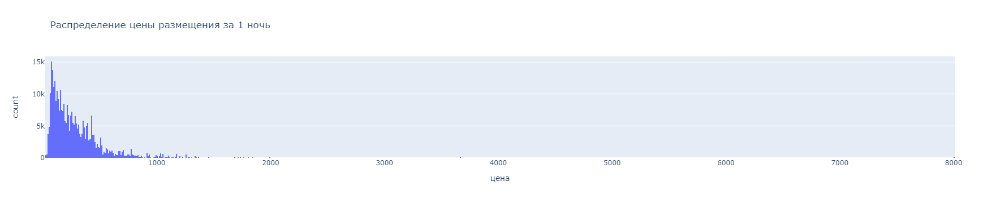

In [70]:
fig = px.histogram(df_final['full_price'], title='Распределение цены размещения за 1 ночь', nbins=1000, labels={'value': 'цена', 'count':'Количество '})
fig.update_layout(showlegend=False)

fig.show()

#### Оценим столбец `amenities`

`amenities` - это категориальный признак на сайте Airbnb, который объяняет наличие какого-либо удобства на объекте.  
Оценим значения:

In [71]:
df_final['amenities'].sample(10)

53312                                 {"Wireless Internet"}
2402      {TV,Internet,"Wireless Internet","Air Conditio...
187297    {TV,"Cable TV",Internet,"Wireless Internet","A...
80091     {Kitchen,"Free Parking on Premises",Gym,"Hot T...
234800    {"Wireless Internet",Kitchen,Heating,Washer,Dr...
211899    {TV,Internet,"Wireless Internet","Air Conditio...
218568    {TV,Internet,"Wireless Internet",Kitchen,"Pets...
152461    {TV,Internet,"Wireless Internet","Air Conditio...
312540    {TV,"Cable TV",Internet,"Wireless Internet","A...
104547    {TV,"Cable TV",Internet,"Wireless Internet","A...
Name: amenities, dtype: object

Данные выглядят как выгрузка из множества, трансформированная в строку. Давайте попробуем найти все категориальные признаки.

Удалим лишние символы (`{`, `}` и `"`):

In [72]:
for i in range(len(df_final)):
    df_final.amenities[i] = str(df_final.amenities[i]).replace('{', '').replace('}', '').replace('"', '')

In [73]:
df_final['amenities'].sample(10)

19241     Internet,Air Conditioning,Kitchen,Heating,Wash...
33538     Wireless Internet,Air Conditioning,Pets live o...
87620     TV,Cable TV,Wireless Internet,Air Conditioning...
191103    Wireless Internet,Air Conditioning,Kitchen,Gym...
190349    TV,Cable TV,Internet,Wireless Internet,Air Con...
117769    TV,Cable TV,Internet,Wireless Internet,Air Con...
261871    TV,Cable TV,Internet,Wireless Internet,Air Con...
220500    Internet,Wireless Internet,Kitchen,Pets live o...
158334    TV,Cable TV,Internet,Wireless Internet,Air Con...
249031    Wireless Internet,Kitchen,Heating,Smoke Detect...
Name: amenities, dtype: object

Теперь наши данные выглядят как строка с перечислением категориальных признаков через запятую. Превратим строку в список при помощи библиотеки `io`:

In [74]:
# цикл для перебора элементов датафрейма
for i in range(len(df_final)):

    # Для каждого элемента df_final.amenities открывается строковый поток (io.StringIO),
    # который используется как источник для чтения CSV данных с помощью csv.reader(f), создающего объект-ридер.
    with io.StringIO(str(df_final.amenities[i])) as f:
        reader = csv.reader(f)
        
        # Cчитываем только одну строку CSV-данных из ридера и сохраняет ее в row.
        # Элемент df_final.amenities перезаписывается этой одной считанной строкой.
        for row in reader:
            df_final.amenities[i] = row
            break

In [75]:
df_final['amenities'].sample(10)

211335    [Wireless Internet, Kitchen, Heating, Washer, ...
153550    [TV, Internet, Wireless Internet, Air Conditio...
157211    [TV, Internet, Wireless Internet, Air Conditio...
208619    [TV, Internet, Wireless Internet, Air Conditio...
130706    [TV, Cable TV, Internet, Wireless Internet, Ai...
278935    [TV, Wireless Internet, Air Conditioning, Kitc...
111621    [TV, Cable TV, Internet, Air Conditioning, Kit...
193502    [TV, Cable TV, Internet, Wireless Internet, Ai...
66614     [TV, Cable TV, Internet, Wireless Internet, Ai...
311429    [Cable TV, Internet, Wireless Internet, Air Co...
Name: amenities, dtype: object

Мы преобразовали текст в списки для каждого объекта, теперь объединим эти списки в один:

In [76]:
temp_list = []
for i in df_final['amenities']:
    temp_list += i

И найдем все уникальные значения из этого списка:

In [77]:
amenities_list = []
for x in temp_list:
    if x not in amenities_list:
        amenities_list.append(x)

In [78]:
amenities_list

['TV',
 'Internet',
 'Wireless Internet',
 'Air Conditioning',
 'Kitchen',
 'Pets Allowed',
 'Pets live on this property',
 'Dog(s)',
 'Heating',
 'Family/Kid Friendly',
 'Washer',
 'Dryer',
 'Smoke Detector',
 'Carbon Monoxide Detector',
 'Fire Extinguisher',
 'Essentials',
 'Shampoo',
 'Lock on Bedroom Door',
 'Hangers',
 'Hair Dryer',
 'Iron',
 'Cable TV',
 'Free Parking on Premises',
 'First Aid Kit',
 'Safety Card',
 'translation missing: en.hosting_amenity_49',
 'translation missing: en.hosting_amenity_50',
 'Gym',
 'Breakfast',
 'Indoor Fireplace',
 'Laptop Friendly Workspace',
 '24-Hour Check-in',
 'Cat(s)',
 'Hot Tub',
 'Buzzer/Wireless Intercom',
 'Other pet(s)',
 'Washer / Dryer',
 'Smoking Allowed',
 'Suitable for Events',
 'Wheelchair Accessible',
 'Elevator in Building',
 'Pool',
 'Doorman',
 'Paid Parking Off Premises',
 'Free Parking on Street']

Вынесем только важные для нас признаки в отдельный список:

In [79]:
amenities_list_sorted = ['Wireless Internet','TV','Heating','Kitchen','Iron','Washer','Hair Dryer','Air Conditioning','Elevator in Building','Gym','Breakfast','24-Hour Check-in']

И добавим их в наш ДатаФрейм в качестве булевых переменных:

In [80]:
df_final[[amenities_list_sorted]] = 0

In [81]:
# перебираем в цикле значения amenities_list_sorted и сравниваем с значением в столбце `amenities` для каждой строки,
# если значение совпадает, то в соответствующем столбце присваиваем True, иначе False
for i, j in itertools.product(range(len(df_final)), amenities_list_sorted):
    if str(j) in df_final['amenities'][i]:
        df_final[j][i] = True
    else:
        df_final[j][i] = False

In [82]:
df_final[amenities_list_sorted].sample(5)

,Wireless Internet,TV,Heating,Kitchen,Iron,Washer,Hair Dryer,Air Conditioning,Elevator in Building,Gym,Breakfast,24-Hour Check-in
80864,True,True,True,True,True,True,True,True,False,False,False,True
126055,True,True,True,True,False,True,False,True,True,False,False,True
111165,True,True,True,True,True,True,True,True,False,False,False,False
159104,True,True,True,True,False,False,False,True,False,False,False,False
284566,True,True,True,True,True,True,False,True,False,False,False,False


Удаляем столбец `amenities`, т.к. он нам больше не нужен:

In [83]:
df_final.drop(['amenities'], axis=1, inplace=True)

#### Создадим столбец `distance`

`distance` - это геодезическое расстояние (расстояние по поверхности Земли) до зала, где будет проходить конференция, в милях.

Вычислим это расстояние с помощью библиотеки geopy:

In [84]:
df_final['distance'] = 0

for i in range(len(df_final)):
    df_final['distance'][i] = round(geopy.distance.geodesic((42.346195, -71.045637), (df_final.latitude[i], df_final.longitude[i])).miles,3)

Оценим распределение:

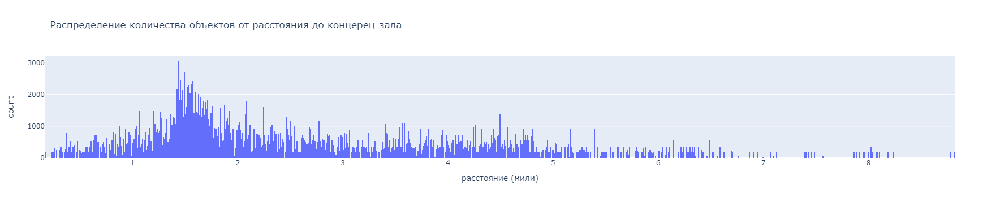

In [85]:
fig = px.histogram(df_final['distance'], title='Распределение количества объектов от расстояния до концерец-зала', nbins=1000, labels={'value': 'расстояние (мили)', 'count':'Количество '})
fig.update_layout(showlegend=False)

fig.show()

#### Добавляем новые метрики

`peoples_for_1_bedroom` - количество гостей на 1 спальню.  
`peoples_for_1_bathroom` - количество гостей на 1 ванную.  
`peoples_for_1_bed` - количество гостей на 1 кровать.  

In [86]:
df_final['peoples_for_1_bedroom'] = 0
df_final['peoples_for_1_bathroom'] = 0
df_final['peoples_for_1_bed'] = 0

In [87]:
df_final['peoples_for_1_bedroom'] = round(df_final['guests_final'] / df_final['bedrooms'],2)
df_final['peoples_for_1_bathroom'] = round(df_final['guests_final'] / df_final['bathrooms'],2)
df_final['peoples_for_1_bed'] = round(df_final['guests_final'] / df_final['beds'],2)

In [88]:
df_final[['guests_included', 'bedrooms', 'bathrooms', 'beds', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']].sample(5)

,guests_included,bedrooms,bathrooms,beds,peoples_for_1_bedroom,peoples_for_1_bathroom,peoples_for_1_bed
227243,2,1,1.0,2.0,2.0,2.0,1.0
271770,1,3,3.0,3.0,1.0,1.0,1.0
62596,1,1,1.0,1.0,1.0,1.0,1.0
118564,1,1,1.0,1.0,1.0,1.0,1.0
4762,1,1,2.0,1.0,1.0,0.5,1.0


#### Фильтрация данных:

Мы сформулировали несколько требований достижения минимального уровня комфорта гостей для объекта:  
- Не более 1-ого госня на одну кровать.  
- Не менее 1-ой ванной на объекте.  

Сделаем срез данных, оставим только те, которые удовлетворяют требованиям: 

In [89]:
df_final.shape

(320588, 41)

In [90]:
df_final_sorted = df_final[(df_final.bathrooms >= 1)].copy()
df_final_sorted.reset_index(drop = True, inplace = True)

In [91]:
df_final_sorted.shape

(318778, 41)

In [92]:
df_final_sorted.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318778 entries, 0 to 318777
Data columns (total 41 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   listing_id              318778 non-null  int64         
 1   date                    318778 non-null  datetime64[ns]
 2   price                   318778 non-null  int32         
 3   house_rules             233062 non-null  object        
 4   street                  318778 non-null  object        
 5   neighbourhood_cleansed  318778 non-null  object        
 6   latitude                318778 non-null  float64       
 7   longitude               318778 non-null  float64       
 8   is_location_exact       318778 non-null  object        
 9   property_type           318778 non-null  object        
 10  room_type               318778 non-null  object        
 11  accommodates            318778 non-null  int64         
 12  bathrooms               318778

In [93]:
df_final_sorted.drop(['house_rules'], axis=1, inplace=True)

### Оценим ДатаФрейм `df_reviews`

In [94]:
df_reviews

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,1178162,4724140,2013-05-21,4298113,Olivier,My stay at islam's place was really cool! Good...
1,1178162,4869189,2013-05-29,6452964,Charlotte,Great location for both airport and city - gre...
2,1178162,5003196,2013-06-06,6449554,Sebastian,We really enjoyed our stay at Islams house. Fr...
3,1178162,5150351,2013-06-15,2215611,Marine,The room was nice and clean and so were the co...
4,1178162,5171140,2013-06-16,6848427,Andrew,Great location. Just 5 mins walk from the Airp...
...,...,...,...,...,...,...
68270,7462268,80537457,2016-06-18,22034145,Antonio,Joe y su mujer son encantadores. La habitación...
68271,7462268,83640094,2016-07-03,40052513,Steve,Joe was on his way to Jamaica to be married! o...
68272,7462268,85797088,2016-07-13,77129134,Nick,The room was very clean as were the bathrooms ...
68273,7462268,97264637,2016-08-26,15799803,Vid,Staying in Lower Allston at Joe and Nancy's pl...


In [95]:
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68275 entries, 0 to 68274
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   listing_id     68275 non-null  int64 
 1   id             68275 non-null  int64 
 2   date           68275 non-null  object
 3   reviewer_id    68275 non-null  int64 
 4   reviewer_name  68275 non-null  object
 5   comments       68222 non-null  object
dtypes: int64(3), object(3)
memory usage: 3.1+ MB


In [96]:
df_reviews.isna().sum()

listing_id        0
id                0
date              0
reviewer_id       0
reviewer_name     0
comments         53
dtype: int64

Удалим пропуски:

In [97]:
df_reviews = df_reviews.dropna(subset=['comments'])
df_reviews.reset_index(drop = True, inplace = True)

Оценим 20 самых частовсречающихся комментариев:

In [98]:
df_reviews.comments.value_counts().head(20)

comments
The host canceled this reservation the day before arrival. This is an automated posting.    112
The host canceled this reservation 3 days before arrival. This is an automated posting.      29
The host canceled this reservation 2 days before arrival. This is an automated posting.      28
The reservation was canceled the day before arrival. This is an automated posting.           28
The host canceled this reservation 5 days before arrival. This is an automated posting.      28
The host canceled this reservation 9 days before arrival. This is an automated posting.      24
The host canceled this reservation 6 days before arrival. This is an automated posting.      22
The host canceled this reservation 4 days before arrival. This is an automated posting.      21
The host canceled this reservation 7 days before arrival. This is an automated posting.      21
The host canceled this reservation 10 days before arrival. This is an automated posting.     19
The host canceled this reservat

Добавим столбец `host_cancelation` и для каждого случая отмены бронирования хостом проставим значение *True*, во всех остальных случаях *False*:

In [99]:
df_reviews['host_cancelation'] = False
df_reviews['host_cancelation'][df_reviews['comments'].str.contains('This is an automated posting')] = True

Оценим сколько было отмен:

In [100]:
df_reviews['host_cancelation'].value_counts()

host_cancelation
False    67256
True       966
Name: count, dtype: int64

Запишим эти строки в отдельный временный ДатаФрейм:

In [101]:
df_temp = df_reviews.listing_id[df_reviews['host_cancelation'] == True].value_counts()
df_temp = df_temp.reset_index()
df_temp

,listing_id,count
0,2898226,13
1,4699828,10
2,2360109,9
3,10552485,7
4,568234,7
...,...,...
626,5639731,1
627,8861069,1
628,4964365,1
629,7961477,1


Выделим тех, кто отменял более 3-х раз, найдем сколько их:

In [102]:
len(df_temp.listing_id[df_temp['count'] > 3].to_list())

30

Добавим их в список `host_cancellation_id_list`:

In [103]:
host_cancellation_id_list = df_temp.listing_id[df_temp['count'] > 3].to_list()

Мы хотели отсортировать такие варианты бронирования и удалить их из общей выборки, но т.к. Airbnb выступает партнером конференции, то он берет все риски отмены бронирования хостом на себя. Поэтому данные остаются.

In [104]:
# df_final_sorted = df_final_sorted[~df_final_sorted.listing_id.isin(host_cancellation_id_list)]

In [105]:
df_final_sorted.shape

(318778, 40)

#### Оценим столбец `bed_type`

`bed_type` - это тип кровати. Оценим распределение типов кроватей:

In [106]:
df_final_sorted['bed_type'].value_counts()

bed_type
Real Bed         306383
Airbed             4581
Futon              4185
Pull-out Sofa      2661
Couch               968
Name: count, dtype: int64

Оставим только *Real bed*:

In [107]:
df_final_sorted = df_final_sorted[df_final_sorted['bed_type'] == 'Real Bed']

In [108]:
df_final_sorted.shape

(306383, 40)

#### Оценим столбец `room_type`

`room_type` - это типы помещений. Оценим распределение:

In [109]:
df_final_sorted['room_type'].value_counts()

room_type
Entire home/apt    184289
Private room       117589
Shared room          4505
Name: count, dtype: int64

Удалим *Shared room*:

In [110]:
df_final_sorted = df_final_sorted[(df_final_sorted['room_type'] == 'Entire home/apt')|(df_final_sorted['room_type'] == 'Private room')]

In [111]:
df_final_sorted.shape

(301878, 40)

#### Оценим столбец `property_type`

`property_type` - это тип собственности. Оценим распределение:

In [112]:
df_final_sorted['property_type'].value_counts()

property_type
Apartment          209964
House               59207
Condominium         16295
Bed & Breakfast      5433
Townhouse            4103
Loft                 2707
Boat                 1983
Other                1456
Entire Floor          423
Villa                 181
Guesthouse             63
Dorm                   63
Name: count, dtype: int64

Оставим только: *Apartment, House, Condominium, Bed & Breakfast, Townhouse, Villa*

In [113]:
property_type_list = ['Apartment', 'House', 'Condominium', 'Bed & Breakfast', 'Townhouse', 'Villa']

In [114]:
df_final_sorted = df_final_sorted[(df_final_sorted['property_type'].isin(property_type_list))]

In [115]:
df_final_sorted.reset_index(drop = True, inplace = True)

In [116]:
df_final_sorted.shape

(295183, 40)

#### Создадим столбец `full_price_for_1_people` и `guests_final`

`full_price_for_1_people` - это сумма аренды на 1 день для 1 человека. Рассчитывается путем отношения суммы бронирования на день (столбец `full_price`) и количества кроватей (столбец `beds`).

In [117]:
df_final_sorted['full_price_for_1_people'] = df_final_sorted['full_price'] / df_final_sorted['guests_final']

### Экспорт данных:

In [118]:
df_final_sorted.to_excel("calendar_sorted.xlsx", index=False)

### Визуализация объектов на карте:

Отметим точками на карте те объекты, которые мы решили арендовать для конференции:

#### Вариант с самой большой удовлетворенностью

Возьмем предварительно подготовленный список id объектов и запишие его в *list_90*:

In [119]:
list_90 = [13884549,9918240,11300899,9232355,10138792,6609546,13924495,8252058,12560987,13466910,994138,12891323,395975,5755910,10356880,13477535,1458081,9844242,8402408,10138904,5581575,6310903,11757166,11211273,14843050
,10945774,12441,10311094,13110631,2754975,12309083,3749523,7840797,13926017,11757376,3890373,257588,5970118,11371205,8052617,2021274,12020829,14124430,9841140,12047758,5940069,4863108,4699742,13514017,4863101,11121872,14389002
,11758169,5454513,5455004,5455293,6213822,8471852,10164810,11863590,11648688,11649321,6629066,10850420,5952474,6296656,8271384,5851489,13942919]

Отсортируем наш датафрейм по датам и id, результат запишим в датафрейм df_90:

In [120]:
df_90 = df_final_sorted[(df_final_sorted['listing_id'].isin(list_90)) & (df_final_sorted['date'] >= '2017-06-13') & (df_final_sorted['date'] <= '2017-06-15')].copy()
df_90.reset_index(drop = True, inplace = True)

In [121]:
df90 = df_90[['date', 'listing_id', 'latitude', 'longitude', 'neighbourhood_cleansed', 'distance', 'property_type', 'room_type', 'minimum_nights', 'security_deposit', 'cleaning_fee', 'price', 'full_price', 'full_price_for_1_people', 'guests_final', 'accommodates', 'beds', 'extra_people', 'bedrooms', 'bathrooms', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']]
df90

,date,listing_id,latitude,longitude,neighbourhood_cleansed,distance,property_type,room_type,minimum_nights,security_deposit,...,full_price_for_1_people,guests_final,accommodates,beds,extra_people,bedrooms,bathrooms,peoples_for_1_bedroom,peoples_for_1_bathroom,peoples_for_1_bed
0,2017-06-13,9841140,42.363788,-71.055027,North End,1.306,Condominium,Entire home/apt,3,0,...,157.222222,3.0,6,3.0,35,2,2.0,1.5,1.5,1.0
1,2017-06-14,9841140,42.363788,-71.055027,North End,1.306,Condominium,Entire home/apt,3,0,...,157.222222,3.0,6,3.0,35,2,2.0,1.5,1.5,1.0
2,2017-06-15,9841140,42.363788,-71.055027,North End,1.306,Condominium,Entire home/apt,3,0,...,157.222222,3.0,6,3.0,35,2,2.0,1.5,1.5,1.0
3,2017-06-13,5755910,42.365724,-71.058388,North End,1.498,Apartment,Entire home/apt,3,250,...,96.666667,3.0,4,3.0,20,2,2.0,1.5,1.5,1.0
4,2017-06-14,5755910,42.365724,-71.058388,North End,1.498,Apartment,Entire home/apt,3,250,...,96.666667,3.0,4,3.0,20,2,2.0,1.5,1.5,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,2017-06-14,395975,42.336440,-71.028744,South Boston,1.096,Apartment,Private room,1,0,...,96.333333,1.0,3,1.0,20,1,1.0,1.0,1.0,1.0
203,2017-06-15,395975,42.336440,-71.028744,South Boston,1.096,Apartment,Private room,1,0,...,96.333333,1.0,3,1.0,20,1,1.0,1.0,1.0,1.0
204,2017-06-13,5851489,42.339797,-71.048814,South Boston,0.471,Apartment,Private room,1,500,...,352.333333,1.0,1,2.0,25,1,1.0,1.0,1.0,0.5
205,2017-06-14,5851489,42.339797,-71.048814,South Boston,0.471,Apartment,Private room,1,500,...,352.333333,1.0,1,2.0,25,1,1.0,1.0,1.0,0.5


Экспортируем датафрейм и отметим точки на карте Бостона:

In [122]:
df_90[['date', 'listing_id','latitude', 'longitude', 'neighbourhood_cleansed', 'distance', 'property_type', 'room_type', 'minimum_nights', 'security_deposit', 'cleaning_fee', 'price', 'full_price', 'full_price_for_1_people', 'guests_final', 'accommodates', 'beds', 'extra_people', 'bedrooms', 'bathrooms', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']].to_excel("stf_90.xlsx", index=False)

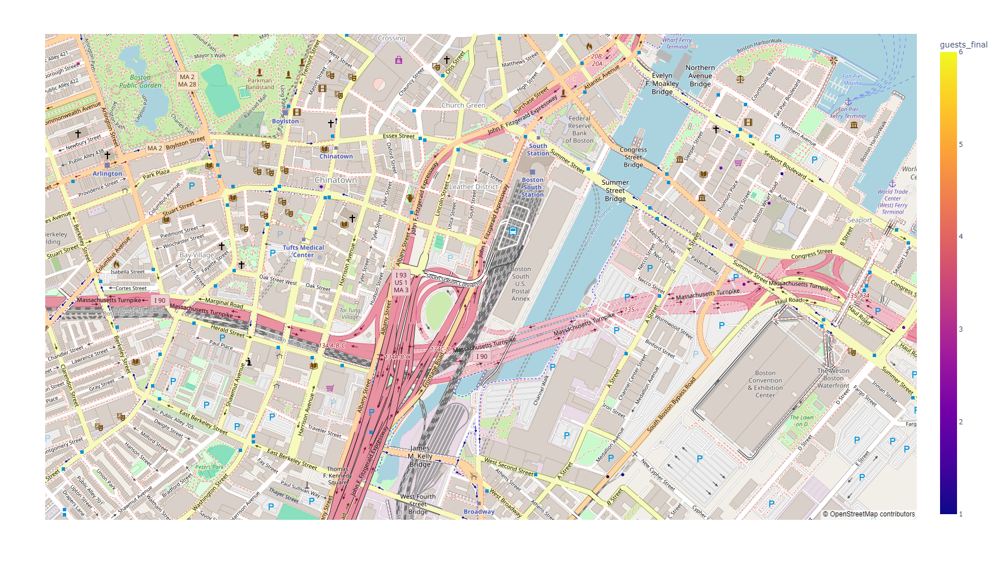

In [124]:
fig = px.scatter_mapbox(df90, lat="latitude", lon="longitude", zoom=15, height=1000,width=1000, color='guests_final')
fig.update_layout(mapbox_style="open-street-map") 
fig.show()

#### Вариант с самой низкой стоимостью

Возьмем предварительно подготовленный список id объектов и запишие его в *list_80*:

In [125]:
list_80 =[11861063,2583074,8065282,13937181,3575220,4461111,4216208,9854083,9813223,2776143,4223387,9894686,12020004,1584362,14253149,7489883,4767023,8904297,1472520,12856007,1529321,1544702,9415712,14092792,1936861,8469464,
          8813451,8814215,14647962,10742655,377474,6014737,13443949,13032590,3021446,13393418,3898015,14849141,8814479,12811191,14303090,1668313,13531200,447826,10021398,3897995,12052820,14682931,4331214,10328539,3897963,1861070,
          3601424,4609785,8482847,10610205,9711934,8153848,3602379,14898198,7006683,14868157,1810172,14824684,6626933,14503389,5870922,1321422,4573458,2843596,4065322,7741566,6923446,11452297,13225005,14251839,10070404,10945558,
          1803138,1881180,14595823,6240901,14467554,14603878,4614037,10859498,14707780,4196643,14844149,8274008]

Отсортируем наш датафрейм по датам и id, результат запишим в датафрейм df_80:

In [126]:
df_80 = df_final_sorted[(df_final_sorted['listing_id'].isin(list_80)) & (df_final_sorted['date'] >= '2017-01-23') & (df_final_sorted['date'] <= '2017-01-25')].copy()
df_80.reset_index(drop = True, inplace = True)

In [127]:
df80 = df_80[['date', 'listing_id', 'latitude', 'longitude', 'neighbourhood_cleansed', 'distance', 'property_type', 'room_type', 'minimum_nights', 'security_deposit', 'cleaning_fee', 'price', 'full_price', 'full_price_for_1_people', 'guests_final', 'accommodates', 'beds', 'extra_people', 'bedrooms', 'bathrooms', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']]
df80

,date,listing_id,latitude,longitude,neighbourhood_cleansed,distance,property_type,room_type,minimum_nights,security_deposit,...,full_price_for_1_people,guests_final,accommodates,beds,extra_people,bedrooms,bathrooms,peoples_for_1_bedroom,peoples_for_1_bathroom,peoples_for_1_bed
0,2017-01-23,1668313,42.281942,-71.133372,Roslindale,6.314,House,Private room,1,0,...,70.333333,1.0,1,1.0,0,1,1.0,1.0,1.00,1.0
1,2017-01-24,1668313,42.281942,-71.133372,Roslindale,6.314,House,Private room,1,0,...,70.333333,1.0,1,1.0,0,1,1.0,1.0,1.00,1.0
2,2017-01-25,1668313,42.281942,-71.133372,Roslindale,6.314,House,Private room,1,0,...,70.333333,1.0,1,1.0,0,1,1.0,1.0,1.00,1.0
3,2017-01-23,2583074,42.279648,-71.136059,Roslindale,6.523,Villa,Private room,2,0,...,40.000000,1.0,1,1.0,0,1,3.0,1.0,0.33,1.0
4,2017-01-24,2583074,42.279648,-71.136059,Roslindale,6.523,Villa,Private room,2,0,...,40.000000,1.0,1,1.0,0,1,3.0,1.0,0.33,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,2017-01-24,11452297,42.385516,-71.080256,Charlestown,3.241,Apartment,Entire home/apt,2,200,...,88.555556,3.0,6,3.0,0,2,2.0,1.5,1.50,1.0
266,2017-01-25,11452297,42.385516,-71.080256,Charlestown,3.241,Apartment,Entire home/apt,2,200,...,88.555556,3.0,6,3.0,0,2,2.0,1.5,1.50,1.0
267,2017-01-23,14603878,42.385226,-71.080923,Charlestown,3.243,Apartment,Private room,1,100,...,92.333333,1.0,2,1.0,30,1,1.0,1.0,1.00,1.0
268,2017-01-24,14603878,42.385226,-71.080923,Charlestown,3.243,Apartment,Private room,1,100,...,92.333333,1.0,2,1.0,30,1,1.0,1.0,1.00,1.0


Экспортируем датафрейм и отметим точки на карте Бостона:

In [128]:
df_80[['date', 'listing_id', 'neighbourhood_cleansed', 'latitude', 'longitude','distance', 'property_type', 'room_type', 'minimum_nights', 'security_deposit', 'cleaning_fee', 'price', 'full_price', 'full_price_for_1_people', 'guests_final', 'accommodates', 'beds', 'extra_people', 'bedrooms', 'bathrooms', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']].to_excel("stf_80.xlsx", index=False)

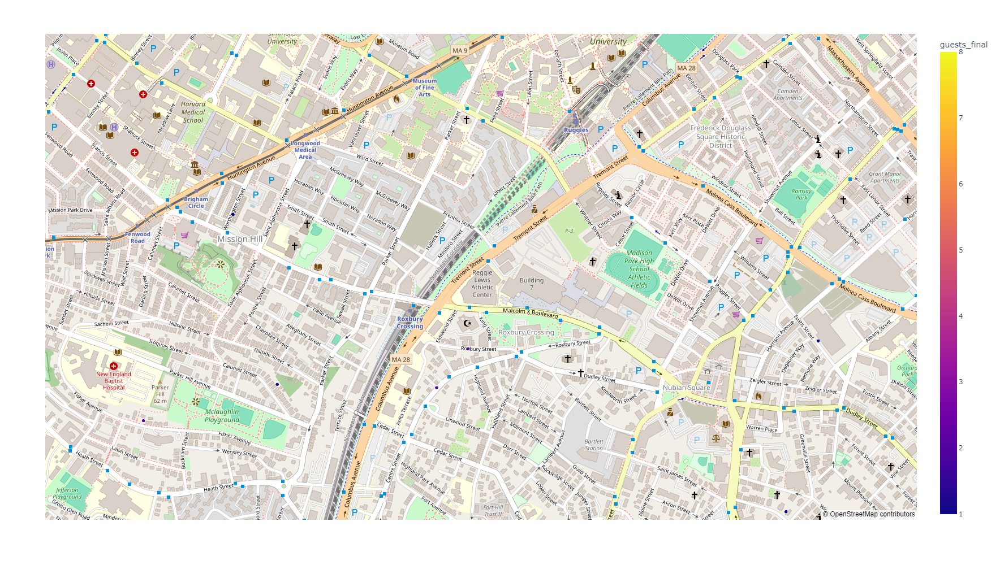

In [129]:
fig = px.scatter_mapbox(df80, lat="latitude", lon="longitude", zoom=15, height=1000,width=1000, color='guests_final')
fig.update_layout(mapbox_style="open-street-map") 
fig.show()

#### Вариант со средней стоимостью и удовлетворенностью

Возьмем предварительно подготовленный список id объектов и запишие его в *list_85*:

In [130]:
list_85 =[13884549,14272646,568234,13098572,11300899,14303761,6728273,12368012,5054601,5927267,13151270,2043541,9953144,13015653,1332786,10807,14636981,11583581,1551467,6053700,6626933,13696794,749247,14262627,1732804,7984949,
          1881298,3730447,8371203,2135451,10356880,11159585,11306586,10211649,1067184,2360109,2384581,8970779,395975,4560053,4196643,2174711,6990023,13477535,5526514,4351970,2014651,8319253,13623390,205894,8720718,1042420,6324649,
          3967611,4364989,5405928,4494419,14486599,9694218,12781774,3522237,1113272,2441095,3294152,8460627,12592117,4405982,14136509,91588,10997047,13345701,9145242,10113230,8814039,8814105,1147871,2846739,7939556,4106372,4861476,
          11912139,14653823,11758169,13509665,5293067,14817983,3765289,526970,8052617,14858003,14463855,14251275,7874552]

Отсортируем наш датафрейм по датам и id, результат запишим в датафрейм df_85:

In [131]:
df_85 = df_final_sorted[(df_final_sorted['listing_id'].isin(list_85)) & (df_final_sorted['date'] >= '2017-04-25') & (df_final_sorted['date'] <= '2017-04-27')].copy()
df_85.reset_index(drop = True, inplace = True)

Экспортируем датафрейм и отметим точки на карте Бостона:

In [132]:
df_85[['date', 'listing_id', 'neighbourhood_cleansed', 'latitude', 'longitude','distance', 'property_type', 'room_type', 'minimum_nights', 'security_deposit', 'cleaning_fee', 'price', 'full_price', 'full_price_for_1_people', 'guests_final', 'accommodates', 'beds', 'extra_people', 'bedrooms', 'bathrooms', 'peoples_for_1_bedroom', 'peoples_for_1_bathroom', 'peoples_for_1_bed']].to_excel("stf_85.xlsx", index=False)

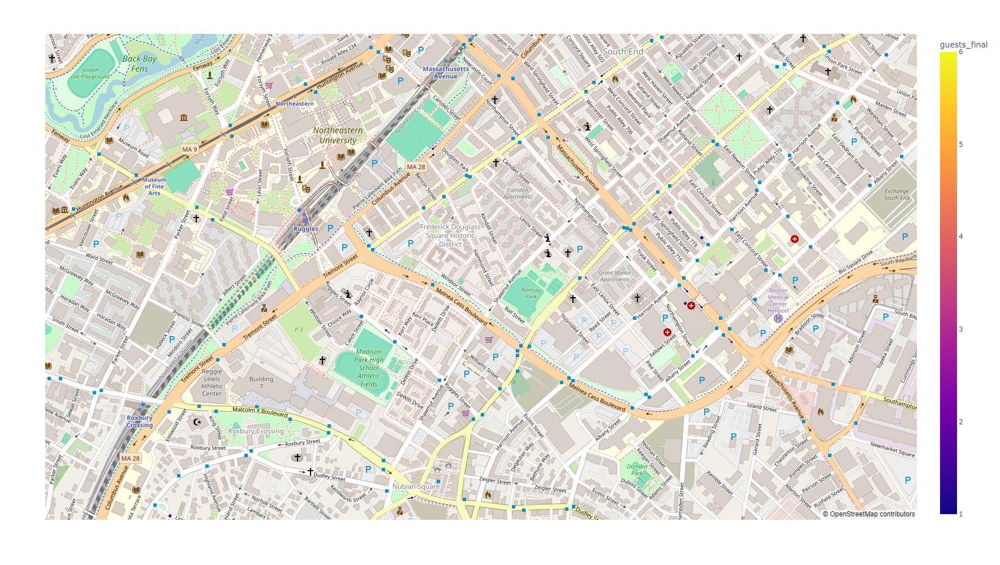

In [133]:
fig = px.scatter_mapbox(df_85, lat="latitude", lon="longitude", zoom=15, height=1000,width=1000, color='guests_final')
fig.update_layout(mapbox_style="open-street-map") 
fig.show()

### Вывод

Мы загрузили данные из 3-х таблиц в ДатаФреймы:  
`calendar.csv` - календарь бронирования объектов. Датафрейм `df_calendar`.  
`listings.csv` - информация по каждому из объектов бронирования. Датафрейм `df_listings`.  
`reviews.csv` - отзывы об объектах бронирования. Датафрейм `df_reviews`.  
  
При первичном анализе обнаружили пропуски и ошибки в типах данных.  
В соответствии с заданием обрезали `df_calendar` и оставили только доступные для аренды на 3 полных дня подрят объекты в первом полугодье 2017 года. Тип данных столбца `date` сменили на *datetime64[ns]*. Проверили на дубликаты и удалили столбец `available`. В столбце `price` изменили тпи данных на *int*, данные привели к целым числам. Визуально оценили получившийся результат, отметили наличие выбросов в области максимальных значений.  
  
Оценили ДатаФрейм `df_listings`. Коллективно выбрали бесполезные для дальнейшего исследования столбцы и удалили их. переименовали столбец `id` в `listings_id`, чтобы объединить 2 ДатаФрейма. Объединенный ДатаФрейм назвали `df_final`.  
Еще раз сделали срез данных из объединенного датафрейма по столбцу `maximum_nights`, обновили индекс.  
Столбец `extra_people` привели к виду целых чисел и изменили тип данных на *int*.  
В столбцах `cleaning_fee` и `security_deposit` заменили пропуски на нули. привели данные к виду целых чисел и изменили тип данных на *int*.  
Мы сформулировали правило, что для комфортного пребывания для каждого гостя должна быть отдельная кровать. Оценили столбец `beds`, удалили нулевые значения и пропуски.  
Удалили пропуски из столбца `property_type`.  
Оценили столбец `bedrooms`, удалили нулевые значения и пропуски. Сделали допущение, на основе которого заменили пропуски на 1, а тип данных на *int*.  
Оценили столбец `bathrooms` и удалили пропуски.  
Нашли 58946 пропусков в столбце `review_scores_rating` и обосновали заполнение этих данных. Обнаружили несколько выбросов при визуальной оценке распределения рейтинга.  
Оценили столбец `guests_included`, обосновали замену нулевых значений.  
Добавили столбец `guests_final`, где указали количество гостей, которые будут заселяться.  
Добавили столбец `full_price`, где рассчитали полную стоимость аренды объекта на одну ночь. Подробно расписали формулу расчета `full price`.  
Выделили категориальные признаки из столбца `amenities` в отдельные бинарные столбцы датафрейма. Сам столбец `amenities` удалили.

Создали дополнительный признак `distance`, который характеризует геодезическое расстояние (расстояние по поверхности Земли) до зала, где будет проходить конференция, в милях.  
Добавили новые метрики: `peoples_for_1_bedroom` (количество гостей на 1 спальню), `peoples_for_1_bathroom`(количество гостей на 1 ванну), `peoples_for_1_bed`(количество гостей на 1 крова).  
  
формулировали требования достижения минимального уровня комфорта гостей:
 - Не менее 1-ой ванной комнаты на объекте
 - Не более 1-ого госня на одну кровать

Удалили столбец `house_rules`.  
Мы провели классификацию комментариев в ДатаФрейме `df_reviews` и сформировали список хостов с риском отмены бронирования до заселения. Но т.к. Airbnb выступает партнером конференции, то он берет все риски отмены бронирования хостом на себя. Поэтому мы не будем фильтровать данные на основе этого признака.  

Сформулировали и отсортировали данные по 3-ем категориальным признакам: `bed_type`, `room_type`, `property_type`.  
И добавили столбец `full_price_for_1_people`, который характеризует стоимость 1 дня проживания для 1 человека.
  
Выгрузили получившийся датафрейм в Excel таблицу и реализовали визуализацию результата на карте.